In [1]:
import numpy as np
import astropy.io.fits as fits
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from matplotlib.patches import Circle
plt.rcParams.update({'image.origin': 'lower',
                     'image.interpolation':"nearest"})
import proper
from pathlib import Path
import os
spc730dir = Path(os.getcwd()+'/spc_20190130/*.fits'); print(spc730dir)
spc730wfsdir = Path(os.getcwd()+'/spc730-fresnel-wavefronts/*.fits'); print(spc730wfsdir)

import glob
wf_fpaths = glob.glob(str(spc730wfsdir))

/home/u21/kianmilani/Documents/webbpsf-mydev/spc_20190130/*.fits
/home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/*.fits


In [2]:
poppy_wfs = []; proper_wfs = []
for i,wf_fpath in enumerate(wf_fpaths):
    if 'poppy' in wf_fpath:
        poppy_wfs.append(wf_fpath)
    else:
        proper_wfs.append(wf_fpath)
        
for i,poppy_wf in enumerate(poppy_wfs):
    print(i,poppy_wf)
print('\n')
for i,proper_wf in enumerate(proper_wfs):
    print(i,proper_wf)

0 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_m5_poppy.fits
1 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_oap3_poppy.fits
2 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_secondary_poppy.fits
3 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_lens_poppy.fits
4 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_m4_poppy.fits
5 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_oap4_poppy.fits
6 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_primary_poppy.fits
7 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_oap1_poppy.fits
8 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_image_poppy.fits
9 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/wf_oap7_poppy.fits
10 /home/u21/kianmilani/Documents/webbpsf-mydev/spc730-fresnel-wavefronts/w

0 primary (2, 2048, 2048) (2, 2048, 2048) 0.0023633372 0.0023633372
1 secondary (2, 2048, 2048) (2, 2048, 2048) 0.000460571183306147 0.000460571183306147
2 m3 (2, 2048, 2048) (2, 2048, 2048) 0.00014080132565041 0.00014080132565041
3 m4 (2, 2048, 2048) (2, 2048, 2048) 4.66144911069352e-05 4.66144911069353e-05
4 m5 (2, 2048, 2048) (2, 2048, 2048) 4.02388410060345e-05 4.02388410060351e-05
5 oap1 (2, 2048, 2048) (2, 2048, 2048) 4.02388410060345e-05 4.02388410060351e-05
6 oap2 (2, 2048, 2048) (2, 2048, 2048) 4.63006758495258e-05 4.63008110546162e-05
7 oap3 (2, 2048, 2048) (2, 2048, 2048) 4.63006758495258e-05 4.63008110546162e-05
8 oap4 (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70005966366624e-05
9 spm (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70003189070358e-05
10 oap5 (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70003189070358e-05
11 fpm (2, 2048, 2048) (2, 2048, 2048) 5.88482418069826e-06 1.14938649983229e-05
12 oap6 (2, 2048, 2048) (2, 2048, 2048) 1.70

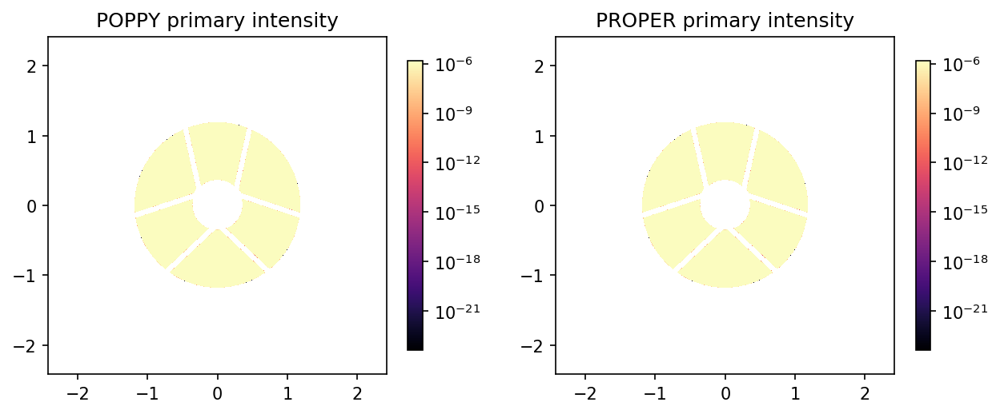

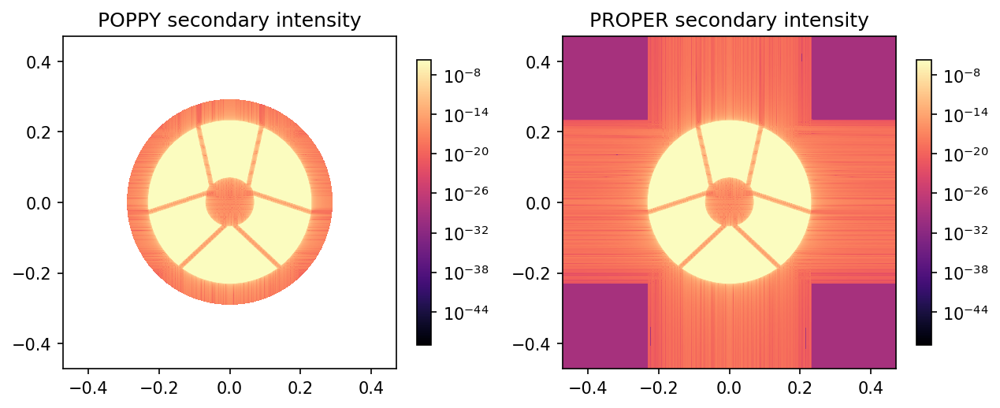

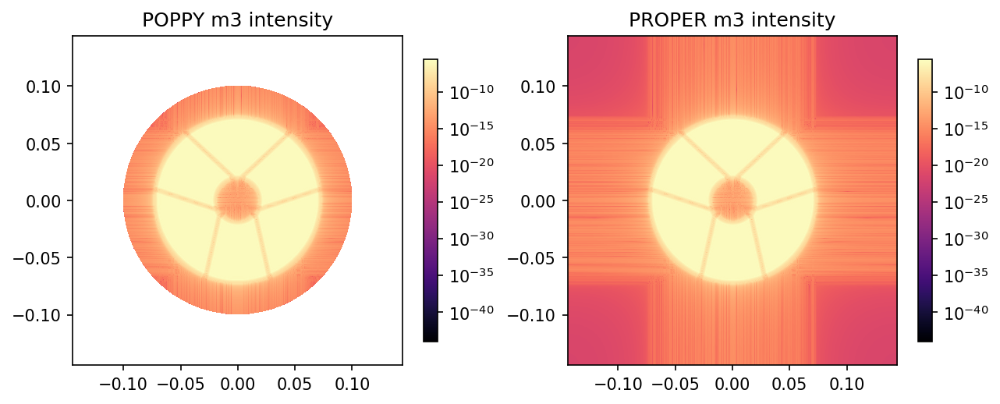

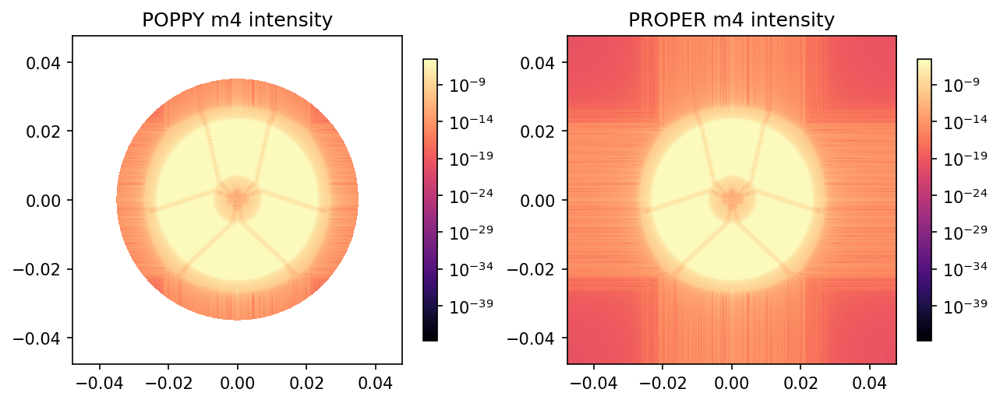

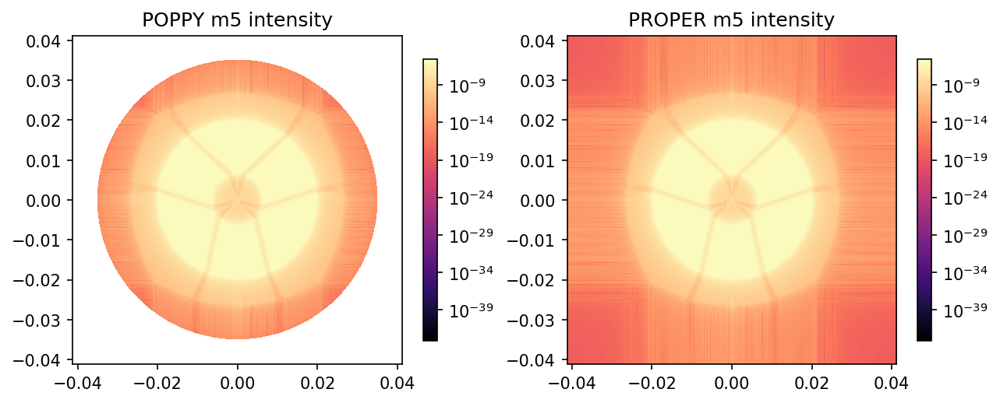

...

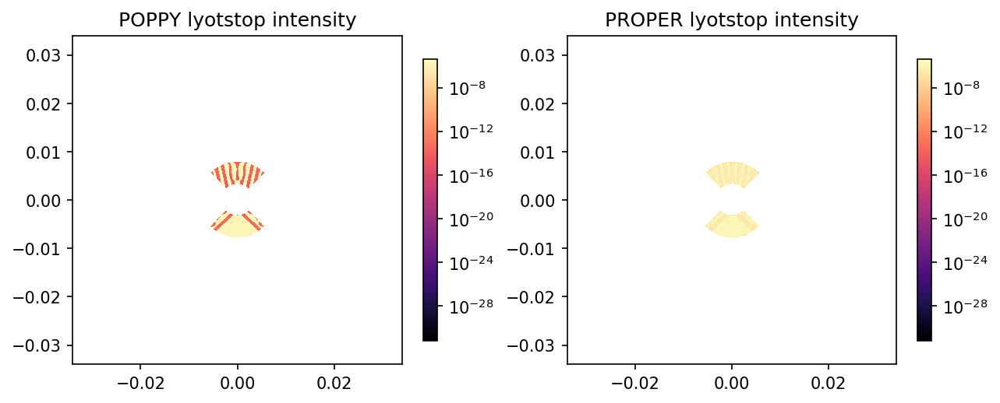

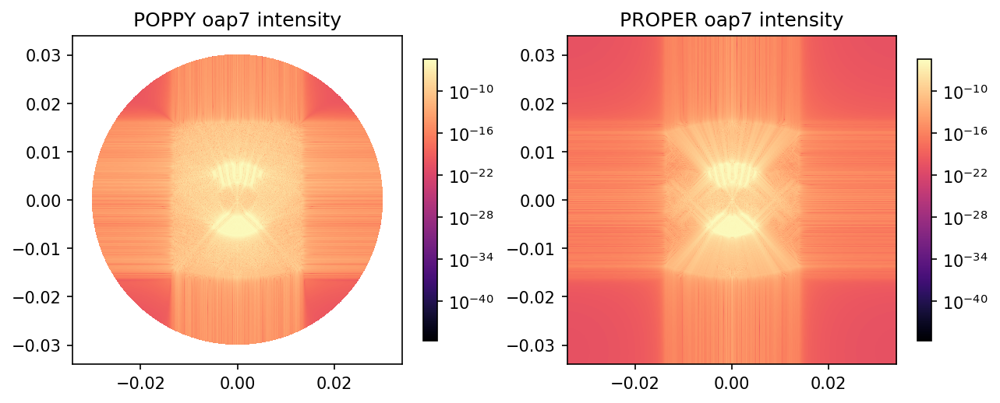

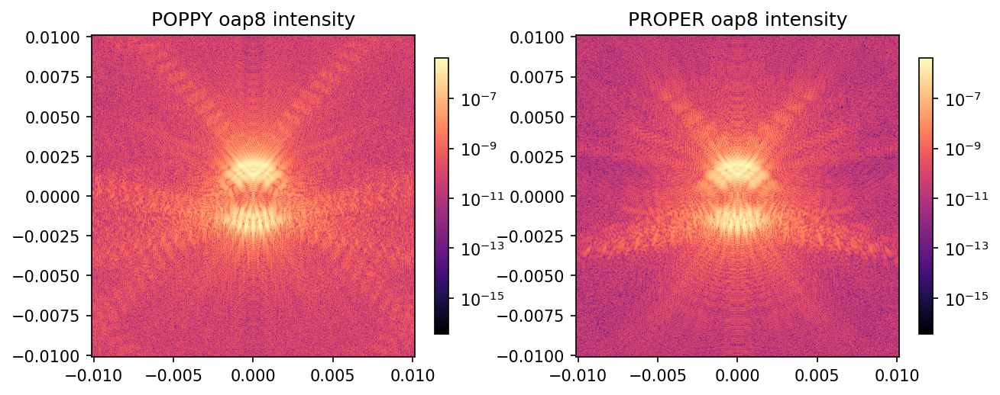

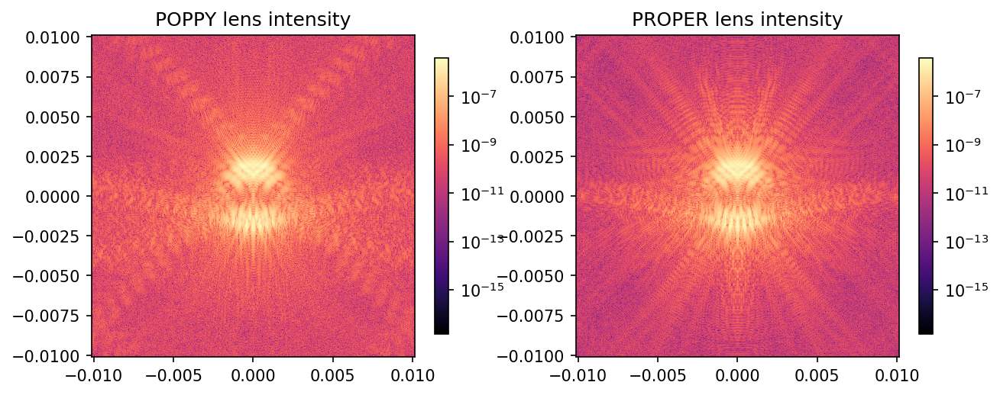

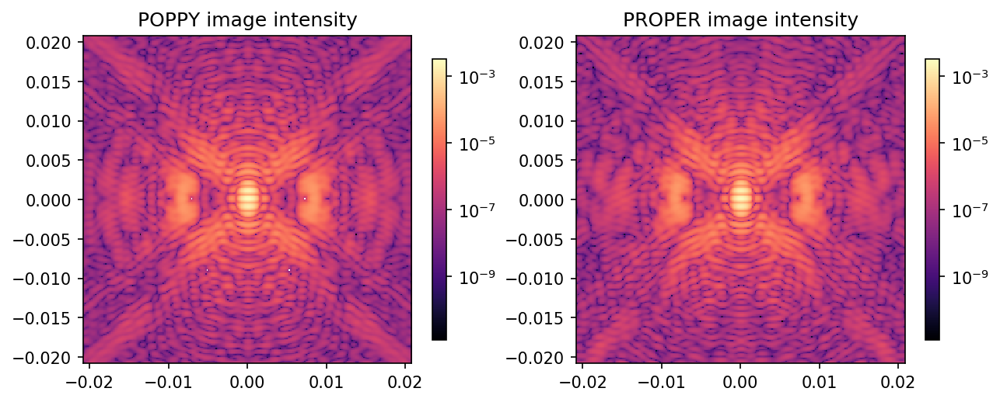

In [8]:
optics = ['primary', 'secondary', 'm3', 'm4', 'm5', 'oap1', 'oap2', 'oap3', 'oap4', 'spm', 'oap5', 'fpm', 'oap6',
          'lyotstop', 'oap7', 'oap8', 'lens', 'image']
for i,optic in enumerate(optics):
    poppy_wf_fname = glob.glob(os.getcwd()+'/spc730-fresnel-wavefronts/*' + optic + '_poppy.fits')[0]
    proper_wf_fname = glob.glob(os.getcwd()+'/spc730-fresnel-wavefronts/*' + optic + '_proper.fits')[0]
#     print(i,poppy_wf_fname, proper_wf_fname)
    
    poppy_wf = fits.getdata(poppy_wf_fname)
    poppy_hdr = fits.getheader(poppy_wf_fname)
    pop_samp = poppy_hdr['PIXELSCL']
    proper_wf = fits.getdata(proper_wf_fname)
    proper_hdr = fits.getheader(proper_wf_fname)
    prop_samp = proper_hdr['PIXELSCL']
    
    npop = poppy_wf.shape[1]
    nprop = proper_wf.shape[1]
    
    if nprop>npop and optic!='image':
        trim = round((nprop-npop)/2)
        trimmed = proper_wf[:,trim:nprop-trim,trim:nprop-trim]
        nprop = npop
        proper_wf = trimmed
    elif npop>nprop and optic!='image':
        trim = round((npop-nprop)/2)
        trimmed = poppy_wf[:,trim:npop-trim,trim:npop-trim]
        npop = nprop
        poppy_wf = trimmed
    
    if optic == 'image':
        n = 256
        trim = round((nprop-n)/2)
        trimmed = proper_wf[:,trim:nprop-trim,trim:nprop-trim]
        nprop = npop
        proper_wf = trimmed
        
        mag = pop_samp/prop_samp
        poppy_wf_int = proper.prop_magnify( poppy_wf[0], mag, n, AMP_CONSERVE=False )
        poppy_wf_phs = proper.prop_magnify( poppy_wf[1], mag, n, AMP_CONSERVE=False )
        poppy_wf = np.zeros(shape=(2,n,n))
        poppy_wf[0] = poppy_wf_int
        poppy_wf[1] = poppy_wf_phs
        
        pop_samp = pop_samp/mag
        
    print(i, optic, poppy_wf.shape, proper_wf.shape, pop_samp, prop_samp)
    
    popext = pop_samp*npop/2; pop_ext = [-popext,popext,-popext,popext]
    propext = prop_samp*nprop/2; prop_ext = [-propext,propext,-propext,propext]
    
    max_int = np.max(poppy_wf[0])
    if max_int < np.max(proper_wf[0]):
        max_int = np.max(proper_wf[0])
    lognorm = LogNorm(vmax=max_int)
    
    fig,ax = plt.subplots(ncols=2, nrows=1, dpi=150, figsize=(10,4))
    
    im1 = ax[0].imshow(poppy_wf[0], norm=lognorm, extent=pop_ext, cmap='magma')
    ax[0].set_title('POPPY '+optic+' intensity')
    fig.colorbar(im1,ax=ax[0],shrink=0.8)
    
    im1 = ax[1].imshow(proper_wf[0], norm=lognorm, extent=prop_ext, cmap='magma')
    ax[1].set_title('PROPER '+optic+' intensity')
    fig.colorbar(im1,ax=ax[1],shrink=0.8)
    

0 primary (2, 2048, 2048) (2, 2048, 2048) 0.0023633372 0.0023633372
1 secondary (2, 2048, 2048) (2, 2048, 2048) 0.000460571183306147 0.000460571183306147
2 m3 (2, 2048, 2048) (2, 2048, 2048) 0.00014080132565041 0.00014080132565041
3 m4 (2, 2048, 2048) (2, 2048, 2048) 4.66144911069352e-05 4.66144911069353e-05
4 m5 (2, 2048, 2048) (2, 2048, 2048) 4.02388410060345e-05 4.02388410060351e-05
5 oap1 (2, 2048, 2048) (2, 2048, 2048) 4.02388410060345e-05 4.02388410060351e-05
6 oap2 (2, 2048, 2048) (2, 2048, 2048) 4.63006758495258e-05 4.63008110546162e-05
7 oap3 (2, 2048, 2048) (2, 2048, 2048) 4.63006758495258e-05 4.63008110546162e-05
8 oap4 (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70005966366624e-05
9 spm (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70003189070358e-05
10 oap5 (2, 2048, 2048) (2, 2048, 2048) 1.70003797403808e-05 1.70003189070358e-05
11 fpm (2, 2048, 2048) (2, 2048, 2048) 5.88482418069826e-06 1.14938649983229e-05
12 oap6 (2, 2048, 2048) (2, 2048, 2048) 1.70

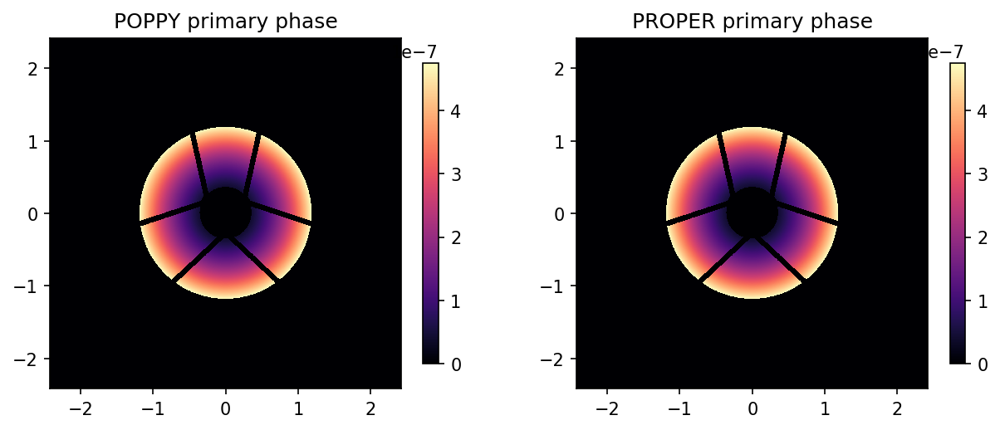

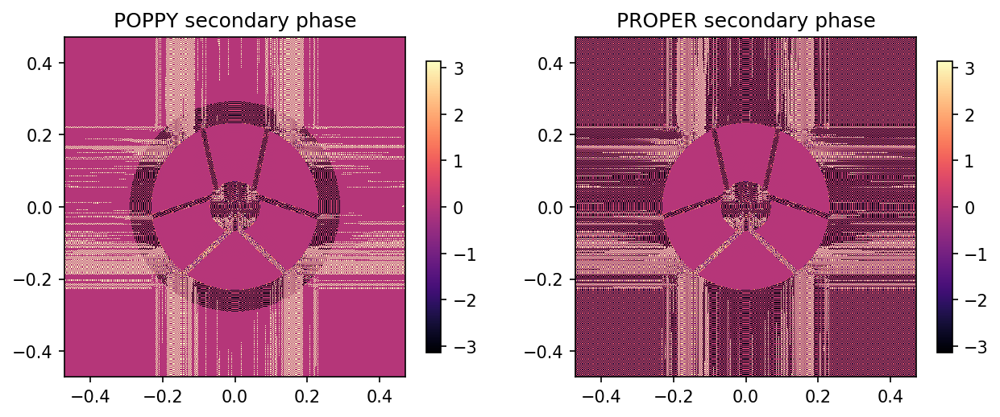

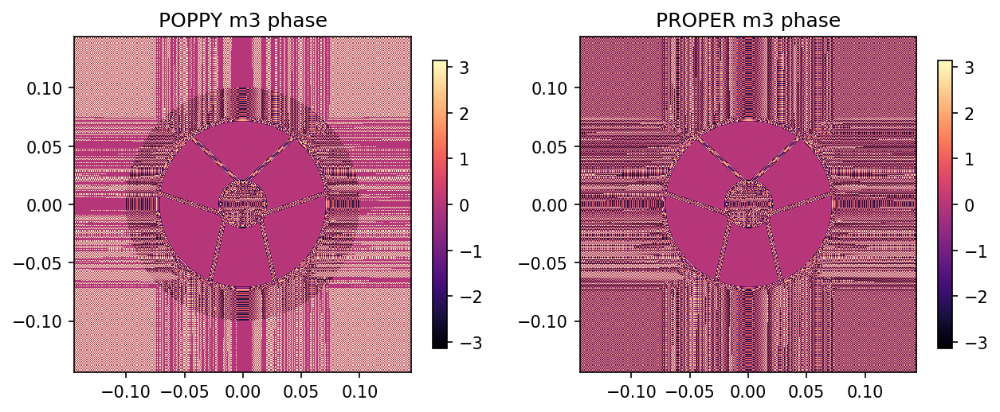

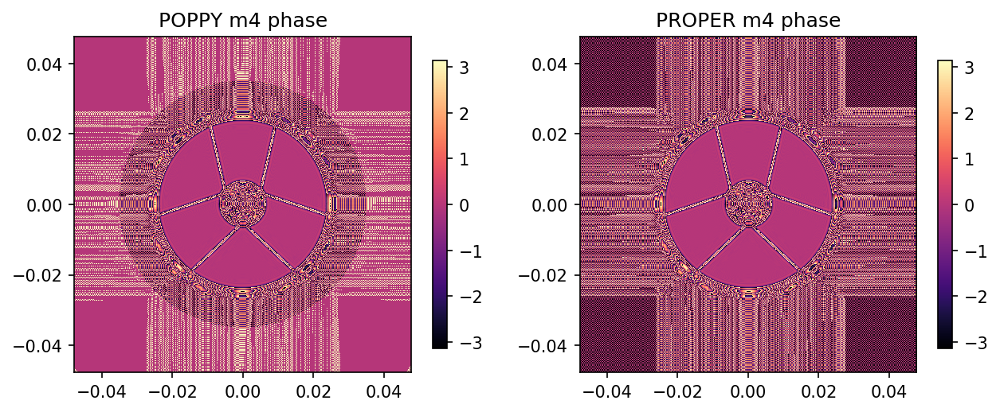

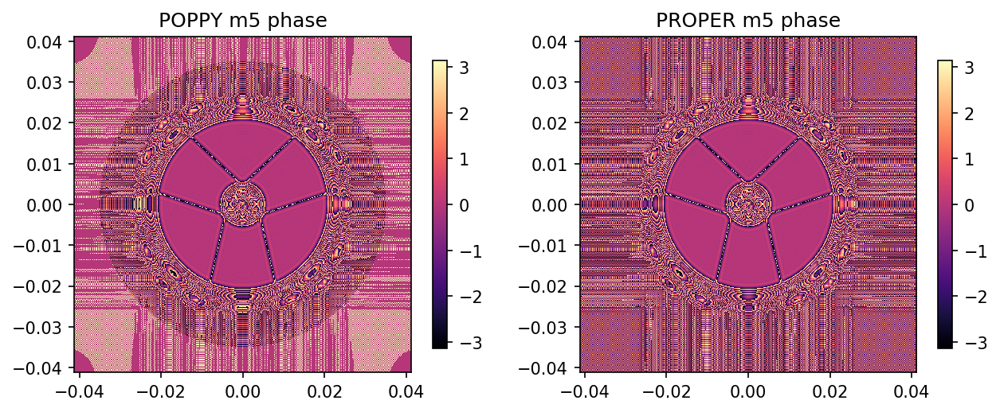

...

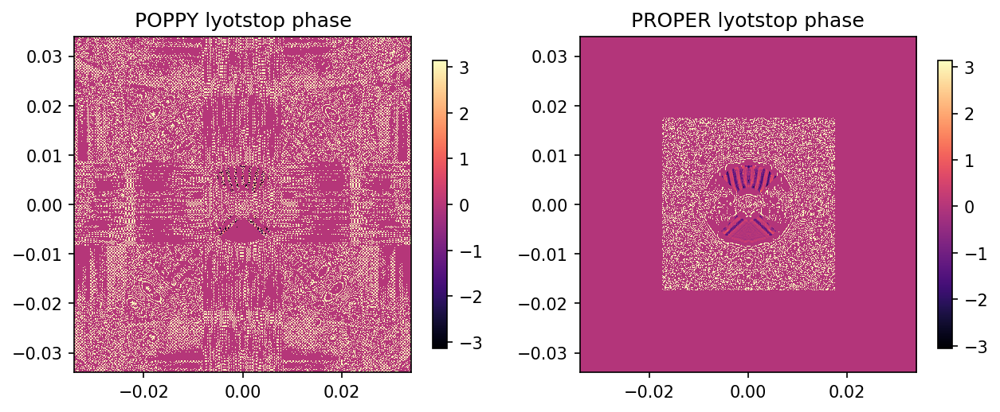

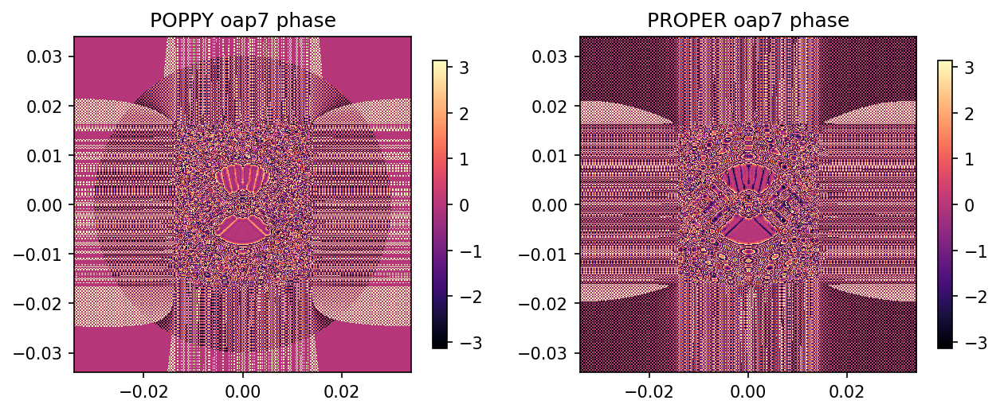

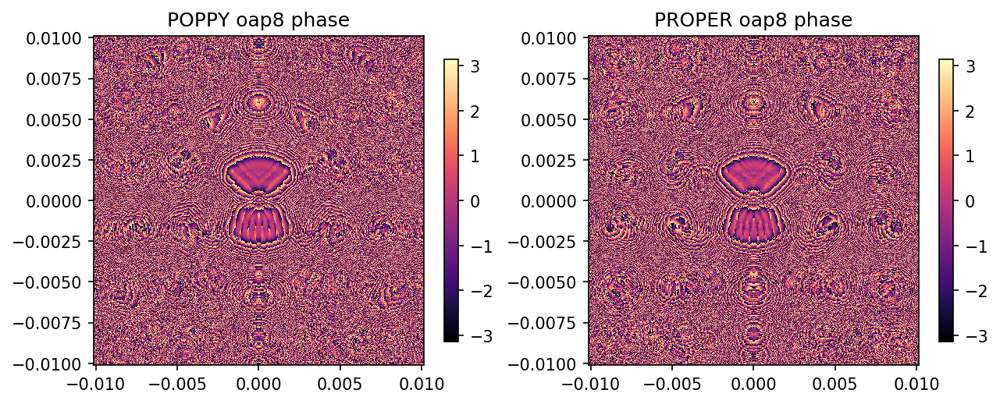

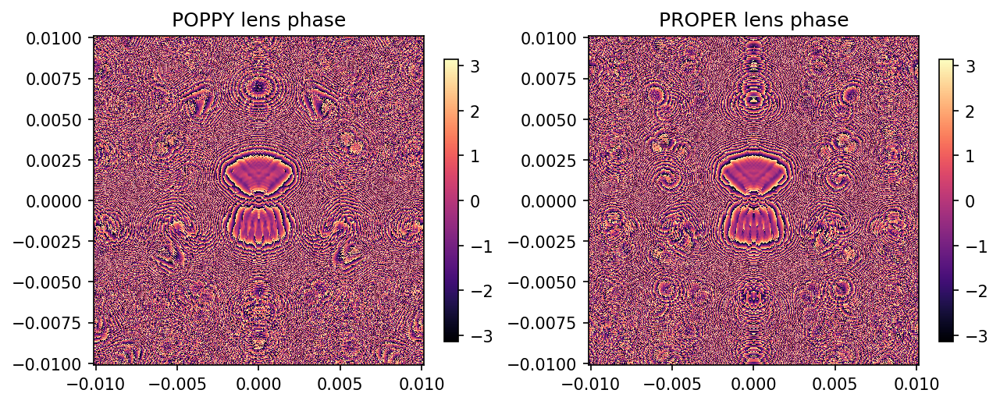

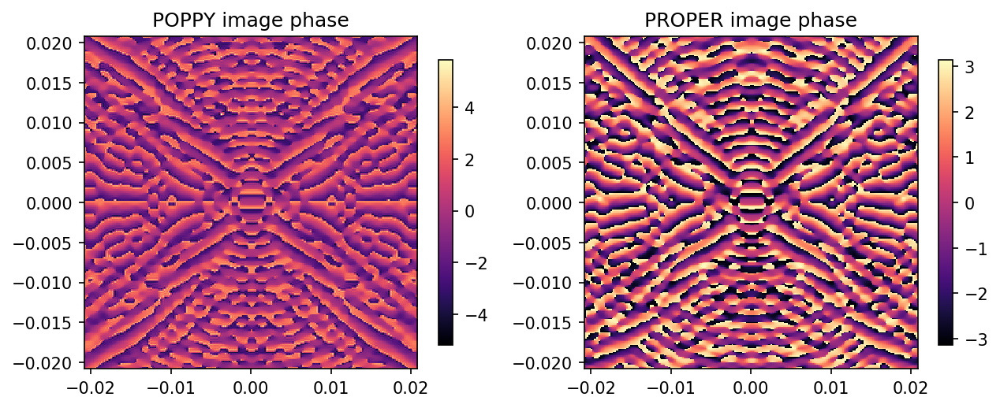

In [9]:
for i,optic in enumerate(optics):
    poppy_wf_fname = glob.glob(os.getcwd()+'/spc730-fresnel-wavefronts/*' + optic + '_poppy.fits')[0]
    proper_wf_fname = glob.glob(os.getcwd()+'/spc730-fresnel-wavefronts/*' + optic + '_proper.fits')[0]
    
    poppy_wf = fits.getdata(poppy_wf_fname)
    poppy_hdr = fits.getheader(poppy_wf_fname)
    pop_samp = poppy_hdr['PIXELSCL']
    proper_wf = fits.getdata(proper_wf_fname)
    proper_hdr = fits.getheader(proper_wf_fname)
    prop_samp = proper_hdr['PIXELSCL']
    
    npop = poppy_wf.shape[1]
    nprop = proper_wf.shape[1]
    
    if nprop>npop:
        trim = round((nprop-npop)/2)
        trimmed = proper_wf[:,trim:nprop-trim,trim:nprop-trim]
        nprop = npop
        proper_wf = trimmed
    elif npop>nprop and optic!='image':
        trim = round((npop-nprop)/2)
        trimmed = poppy_wf[:,trim:npop-trim,trim:npop-trim]
        npop = nprop
        poppy_wf = trimmed
    
    if optic == 'image':
        n = 256
        trim = round((nprop-n)/2)
        trimmed = proper_wf[:,trim:nprop-trim,trim:nprop-trim]
        nprop = npop
        proper_wf = trimmed
        
        mag = pop_samp/prop_samp
        poppy_wf_int = proper.prop_magnify( poppy_wf[0], mag, n, AMP_CONSERVE=False )
        poppy_wf_phs = proper.prop_magnify( poppy_wf[1], mag, n, AMP_CONSERVE=False )
        poppy_wf = np.zeros(shape=(2,n,n))
        poppy_wf[0] = poppy_wf_int
        poppy_wf[1] = poppy_wf_phs
        
        pop_samp = pop_samp/mag
        
    print(i, optic, poppy_wf.shape, proper_wf.shape, pop_samp, prop_samp)
    
    popext = pop_samp*npop/2; pop_ext = [-popext,popext,-popext,popext]
    propext = prop_samp*nprop/2; prop_ext = [-propext,propext,-propext,propext]
    
    fig,ax = plt.subplots(ncols=2, nrows=1, dpi=150, figsize=(10,4))
    
    im1 = ax[0].imshow(poppy_wf[1], extent=pop_ext, cmap='magma')
    ax[0].set_title('POPPY '+optic+' phase')
    fig.colorbar(im1,ax=ax[0],shrink=0.8)
    
    im1 = ax[1].imshow(proper_wf[1], extent=prop_ext, cmap='magma')
    ax[1].set_title('PROPER '+optic+' phase')
    fig.colorbar(im1,ax=ax[1],shrink=0.8)
    

In [4]:
from poppy.matrixDFT import matrix_dft

